In [1]:
from collections import namedtuple
import os
import tempfile
import random
import tensorflow as tf
import numpy as np
from google.protobuf import text_format
from bs4 import BeautifulSoup
import cv2
import pytesseract as pt
import pandas as pd
import dataframe_image as dfi
from imutils import paths, resize
from imutils.object_detection import non_max_suppression
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import matplotlib.image as mpimg
from models.research.object_detection.utils import (
    visualization_utils)
from models.research.object_detection.protos import (
    string_int_label_map_pb2)
from models.research.object_detection.data_decoders.tf_example_decoder import (
    TfExampleDecoder)
from IPython.display import HTML
import config

In [2]:
decoder = TfExampleDecoder(
    label_map_proto_file=config.LABEL_MAP,
    use_display_name=False)

label_map_proto = string_int_label_map_pb2.StringIntLabelMap()

with tf.io.gfile.GFile(config.LABEL_MAP, 'r') as f:
    text_format.Merge(f.read(), label_map_proto)
    class_dict = {}

for entry in label_map_proto.item:
    class_dict[entry.id] = {'name': entry.name}

raw_dataset = list(tf.data.TFRecordDataset(config.TRAIN_RECORD))
random.shuffle(raw_dataset)

In [3]:
%matplotlib inline

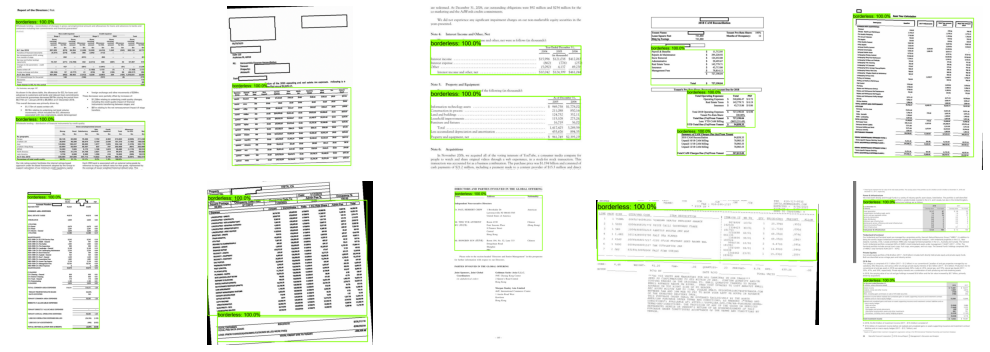

In [4]:
fig, ax = plt.subplots(2, 5, figsize=(15, 5))

for i, raw_record in enumerate(raw_dataset[:10]):

    example = decoder.decode(raw_record)

    image = example['image'].numpy()
    boxes = example['groundtruth_boxes'].numpy()
    classes = example['groundtruth_classes'].numpy()

    scores = np.ones(boxes.shape[0])

    visualization_utils.visualize_boxes_and_labels_on_image_array(
        image,
        boxes,
        classes,
        scores,
        class_dict,
        max_boxes_to_draw=None,
        use_normalized_coordinates=True
    )

    ax.flat[i].axis('off')
    ax.flat[i].imshow(image)

fig.tight_layout()

In [5]:
pt.pytesseract.tesseract_cmd = 'C:/Program Files/Tesseract-OCR/tesseract.exe'

In [6]:
tf.get_logger().setLevel('ERROR')
detect_fn = tf.saved_model.load(config.SAVED_MODEL)

In [7]:
demo_paths = list(paths.list_images(config.DEMO_IMG))
Demo = namedtuple('Demo', ['img_path', 'gt_boxes', 'in_boxes'])
demo_data = []
demo_imgs = []

for i, img_path in enumerate(demo_paths):

    bboxes = []
    img_array = cv2.imread(img_path)
    img_tensor = tf.convert_to_tensor(img_array)
    img_tensor = img_tensor[tf.newaxis, ]

    detections = detect_fn(img_tensor)
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy() for key, value
                  in detections.items()}
    detections['num_detections'] = num_detections
    detections['detection_classes'] = (detections['detection_classes']
                                       .astype(np.int64))

    h = img_array.shape[0]
    w = img_array.shape[1]

    boxes = detections['detection_boxes']
    proba = detections['detection_scores']

    idxs = np.where(proba >= config.INF_TH)
    boxes = boxes[idxs]
    proba = proba[idxs]

    boxes *= (np.stack([h, w, h, w])).astype(int)
    bboxes.append(boxes)

    boxes = non_max_suppression(boxes, proba)
    bboxes.append(boxes)

    fname = img_path.split(os.path.sep)[-1]
    fname = fname[:fname.rfind('.')]
    ANNOT_PATH = os.path.sep.join([config.TEST_SET,
                                   "{}.xml".format(fname)])

    CONTENTS = str(open(ANNOT_PATH).read())
    soup = BeautifulSoup(CONTENTS, 'xml')

    gt_boxes = []
    for o in soup.find_all("object"):
        xMin = int(o.find("xmin").string)
        yMin = int(o.find("ymin").string)
        xMax = int(o.find("xmax").string)
        yMax = int(o.find("ymax").string)
        gt_boxes.append((yMin, xMin, yMax, xMax))

    demo_data.append(Demo(img_path, np.array(gt_boxes), boxes))

    for j in range(2):
        img_copy = img_array.copy()
        for box in bboxes[j]:
            startY, startX, endY, endX = box
            cv2.rectangle(img_copy,
                          (startX, startY),
                          (endX, endY),
                          (0, 0, 255),
                          2)
        demo_imgs.append(img_copy)

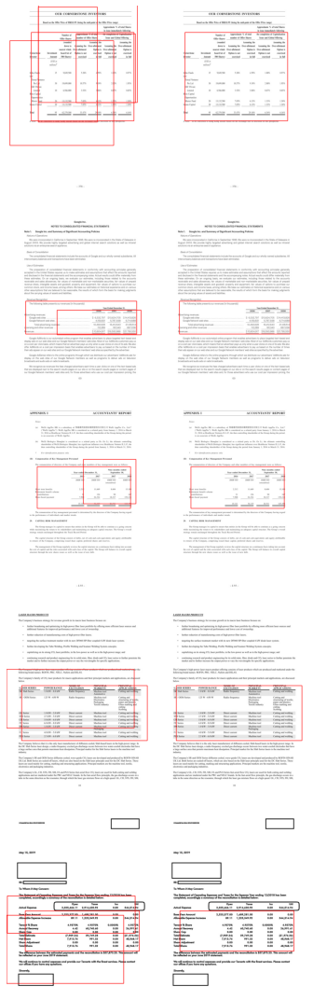

In [8]:
fig, ax = plt.subplots(5, 2, figsize=(5, 15))
for i, im in enumerate(demo_imgs):
    ax.flat[i].axis('off')
    ax.flat[i].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
fig.tight_layout()

In [9]:
def bb_intersection_over_union(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    inter_area = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxA_area = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxB_area = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    iou = inter_area / float(boxA_area + boxB_area - inter_area)
    return iou

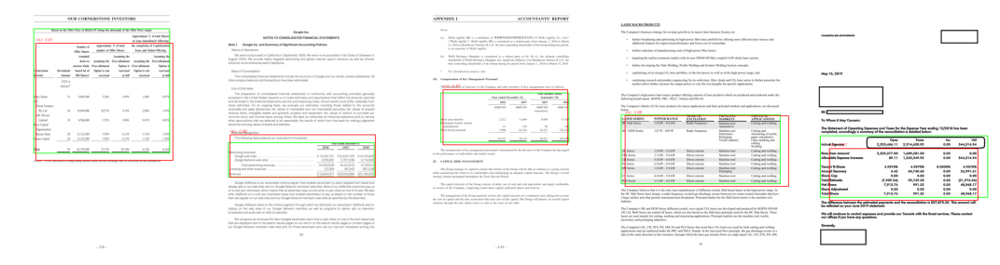

In [10]:
fig, ax = plt.subplots(1, 5, figsize=(15, 5))

for i, d in enumerate(demo_data):
    image = cv2.imread(d.img_path)

    cv2.rectangle(image,
                  tuple(d.gt_boxes[0][[1, 0]]),
                  tuple(d.gt_boxes[0][[3, 2]]),
                  (0, 255, 0),
                  2)

    cv2.rectangle(image,
                  tuple(d.in_boxes[0][[1, 0]]),
                  tuple(d.in_boxes[0][[3, 2]]),
                  (0, 0, 255),
                  2)

    iou_val = bb_intersection_over_union(d.gt_boxes[0], d.in_boxes[0])

    y = d.in_boxes[0][0] - 10 if startY - 10 > 10 else d.in_boxes[0][0] + 10

    cv2.putText(image,
                'IoU: {:.2f}'.format(iou_val),
                (d.in_boxes[0][1], y),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.5,
                (0, 0, 255),
                1)

    ax[i].axis('off')
    ax[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

fig.tight_layout()

In [11]:
dem = demo_data[3]
dem_wdth = dem.in_boxes[0][3] - dem.in_boxes[0][1]
dem_hght = dem.in_boxes[0][2] - dem.in_boxes[0][0]
dem_xmin = dem.in_boxes[0][1]
dem_ymin = dem.in_boxes[0][0]

dem_image = cv2.imread(dem.img_path)
tbl_image = dem_image[dem_ymin: dem_ymin + dem_hght,
                      dem_xmin: dem_xmin + dem_wdth]

tbl_gray = cv2.cvtColor(tbl_image, cv2.COLOR_BGR2GRAY)
tbl_thresh_bin = cv2.threshold(tbl_gray, 127, 255, cv2.THRESH_BINARY)[1]

R = 2.5
tbl_resized = resize(tbl_thresh_bin, width=int(tbl_image.shape[1] // R))

In [12]:
def get_dividers(img, axis):
    blank_lines = np.where(np.all(img == 255, axis=axis))[0]
    filtered_idx = np.where(np.diff(blank_lines) != 1)[0]
    return blank_lines[filtered_idx]

In [13]:
dims = tbl_image.shape[0], tbl_image.shape[1]

tbl_str = np.zeros(dims, np.uint8)
tbl_str = cv2.rectangle(tbl_str, (0, 0), (dims[1] - 1, dims[0] - 1), 255, 1)

for a in [0, 1]:
    dividers = get_dividers(tbl_resized, a)
    start_point = [0, 0]
    end_point = [dims[1], dims[1]]
    for i in dividers:
        i *= R
        start_point[a] = int(i)
        end_point[a] = int(i)
        cv2.line(tbl_str,
                 tuple(start_point),
                 tuple(end_point),
                 255,
                 1)

In [14]:
contours, hierarchy = cv2.findContours(tbl_str,
                                       cv2.RETR_TREE,
                                       cv2.CHAIN_APPROX_SIMPLE)

In [15]:
def sort_contours(cnts, method="left-to-right"):
    reverse = False
    k = 0
    if method in ['right-to-left', 'bottom-to-top']:
        reverse = True
    if method in ['top-to-bottom', 'bottom-to-top']:
        k = 1
    bBoxes = [cv2.boundingRect(c) for c in cnts]
    (cnts, bBoxes) = zip(*sorted(zip(cnts, bBoxes),
                                 key=lambda b: b[1][k],
                                 reverse=reverse))
    return (cnts, bBoxes)

In [16]:
contours, boundingBoxes = sort_contours(contours, method='top-to-bottom')

bb_filtered = [list(t) for t in boundingBoxes
               if t[2] < dims[1] and t[3] < dims[0]]

In [17]:
rows = []
columns = []

for i, bb in enumerate(bb_filtered):
    if i == 0:
        columns.append(bb)
        previous = bb
    else:
        if bb[1] < previous[1] + previous[3]/2:
            columns.append(bb)
            previous = bb
            if i == len(bb_filtered) - 1:
                rows.append(columns)
        else:
            rows.append(columns)
            columns = []
            previous = bb
            columns.append(bb)

In [18]:
outer = []
for r in rows:
    for c in r[::-1]:
        x, y, w, h = (c[0], c[1], c[2], c[3])
        finalimg = tbl_thresh_bin[y: y + h, x: x + w]
        kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2, 1))
        border = cv2.copyMakeBorder(finalimg, 2, 2, 2, 2,
                                    cv2.BORDER_CONSTANT, value=[255, 255])
        resizing = cv2.resize(border, None, fx=2, fy=2,
                              interpolation=cv2.INTER_CUBIC)
        dilation = cv2.dilate(resizing, kernel, iterations=1)
        erosion = cv2.erode(dilation, kernel, iterations=1)

        out = pt.image_to_string(erosion)
        if len(out) == 0:
            out = pt.image_to_string(erosion, config='--psm 3')

        filtered_out = ''.join([c if ord(c) < 128 else ''
                                for c in out]).strip()
        outer.append(filtered_out)

In [19]:
def make_df_image(df):
    with (tempfile.NamedTemporaryFile(mode='wb',
                                      suffix='.jpg',
                                      delete=False)) as df_path:
        dfi.export(df, df_path.name)
        df_img = mpimg.imread(df_path.name)
    return df_img

In [20]:
cells_flat = [c for r in rows for c in r[::-1]]

In [21]:
fig = plt.figure(figsize=(15, 10))
grid = plt.GridSpec(9, 14)

ax_tb = fig.add_subplot(grid[:, :8])
ax_tb.axis('off')
ax_tb.imshow(dem_image)

ax_in = fig.add_subplot(grid[1, 9:13])
ax_in.axis('off')

ax_tx = fig.add_subplot(grid[2, 9:13])
ax_tx.axis('off')

ax_df = fig.add_subplot(grid[4:, 8:])
ax_df.axis('off')

fig.tight_layout()
plt.close(fig)


def update(fr):
    cell_bb = cells_flat[fr]
    cx, cy, cw, ch = (cell_bb[0], cell_bb[1], cell_bb[2], cell_bb[3])
    cell_img = tbl_thresh_bin[cy: cy + ch, cx: cx + cw]

    ax_tb.clear()
    ax_tb.axis('off')
    dem_copy = dem_image.copy()
    cv2.rectangle(dem_copy,
                  (cx + dem_xmin, cy + dem_ymin),
                  (cx + dem_xmin + w, cy + dem_ymin + h),
                  (255, 0, 0),
                  2)
    ax_tb.imshow(dem_copy)

    ax_in.clear()
    ax_in.axis('off')
    ax_in.imshow(cell_img, cmap='gray')

    ax_tx.clear()
    ax_tx.axis('off')
    ax_tx.text(0.5, 0.1,
               outer[fr],
               fontsize=15,
               color='red',
               horizontalalignment='center',
               verticalalignment='center')

    ax_df.clear()
    ax_df.axis('off')
    if fr < len(rows[0]):
        n_cols = fr + 1
    else:
        n_cols = len(rows[0])
    n_rows = fr // len(rows[0]) + 1

    outer_arr = np.array(outer[:fr + 1])
    full_arr = np.full((n_rows, n_cols), '', dtype='<U87')
    full_arr.flat[: len(outer_arr)] = outer_arr
    dem_df = pd.DataFrame(full_arr)
    ax_df.imshow(make_df_image(dem_df))


ani = animation.FuncAnimation(fig,
                              update,
                              frames=len(cells_flat),
                              interval=500)

HTML(ani.to_jshtml())

In [22]:
dataframe = pd.DataFrame(np.array(outer)
                         .reshape(len(rows), 5))
dataframe

,0,1,2,3,4
0,\SER SERIES,POWER RANGE,VUE wr\nEXCITATION,PRINCIPAL\nMARKETS,PRINCIPAL\nAPPLICATLONS
1,> Slab Series,LOKW- 8.0 kW,Radio frequency,Machine lool\nAutomotive,Cutting and welding
2,Lf OLM Series,L253 Wo 650 W,Radio requency,Machine toul\nElectronics\nckaging\nTeatile in...,"Cutting and\nSruccoring of textile,\npanyr and..."
3,- Series,LOKW-2.0 kW,Direct current,Machine teal,Cutting and welding
4,*S Series,ZAKW - SO kW,Direet current,Machine tool,Curing and welding
5,1Scrics,S.OKW - 6.0 kW,Dirvet current,Machine tool,Cutting and welding
6,I Series,B.0KW - ROW,Dirge current,Machiny tual,Cutting and welding
7,A Series,LOkW -3.0kW,Direet current,Machine tool\nPackaging,Cutting and welding
8,Series,S.0 kW - SOW,Dirge current,Machung tual,Cuthing and welchng
9,-S Series,2SKW -6.OkW,Dicvet current,Machine tool,Cutting and welding
